## Exercise type recognition
### We received a series of videos performing differnt exercises in the gym, after saving them in a folder namely Videos, we want to check how many keypoints can be detected throughout the video, using yolov8n pose. In particular we believe that using only videos where the main subject of the video is always trackable, and mantains a minimum of 6 keypoints detected throughout the whole video. For this reason we created some python scripts to analyse the total number of minimum keypoints detected for each video of each exercise.

In [1]:
import os
import sys
import glob
import time
import threading
import csv
import re
import tensorflow as tf
import random
import shutil

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import seaborn as sns

import cv2

import torch

from ultralytics import YOLO

from scipy.stats import zscore

from sklearn.model_selection import (
    train_test_split,
    StratifiedGroupKFold
)
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    classification_report,
    precision_recall_fscore_support,

    ConfusionMatrixDisplay
)


0: 384x640 1 person, 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 15.8ms
Speed: 1.0ms preprocess, 15.8ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 30.3ms
Speed: 0.9ms preprocess, 30.3ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 16.2ms
Speed: 0.8ms preprocess, 16.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 15.9ms
Speed: 0.8ms preprocess, 15.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 17.1ms
Speed: 1.2ms preprocess, 17.1ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 17.0ms
Speed: 1.2ms preprocess, 17.0ms inference, 0.3ms postprocess per image at shape (1, 3, 38

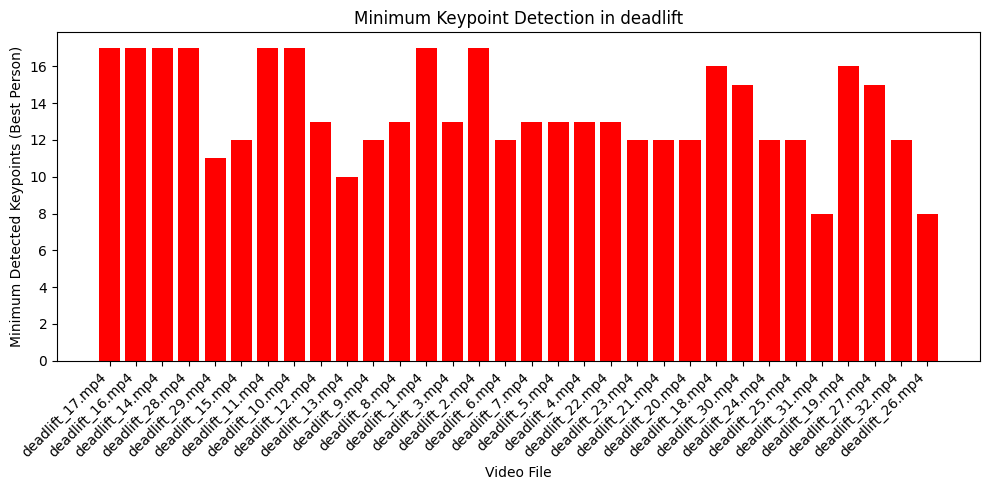


0: 384x640 1 person, 17.2ms
Speed: 0.9ms preprocess, 17.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.2ms
Speed: 0.7ms preprocess, 19.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 16.9ms
Speed: 0.7ms preprocess, 16.9ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 15.9ms
Speed: 0.7ms preprocess, 15.9ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 16.5ms
Speed: 0.7ms preprocess, 16.5ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 16.0ms
Speed: 0.8ms preprocess, 16.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 16.4ms
Speed: 0.7ms preprocess, 16.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 15.3ms
Speed: 0.8ms preprocess, 15.3ms inference, 0.3ms postprocess per image at shape (1, 3, 

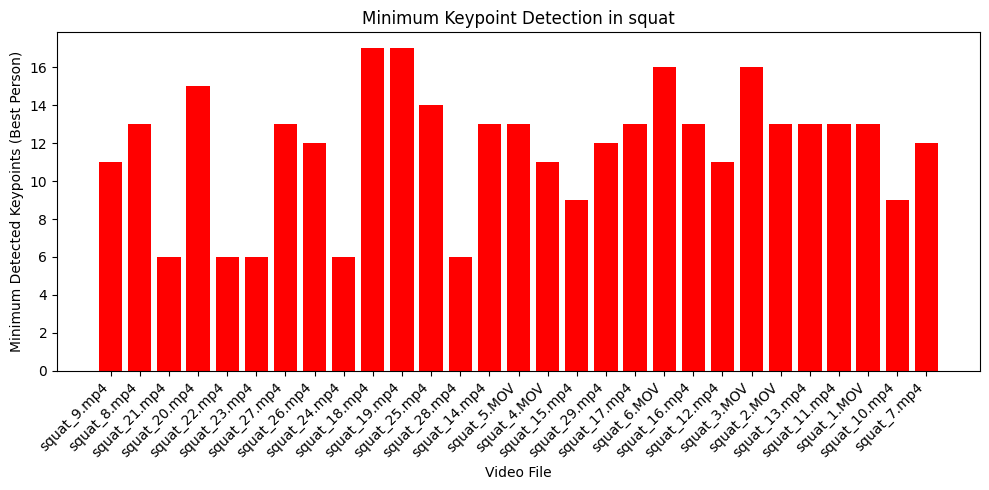


0: 384x640 1 person, 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.4ms
Speed: 1.9ms preprocess, 18.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.2ms
Speed: 1.4ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.3ms postprocess per image at shape (1, 3, 38

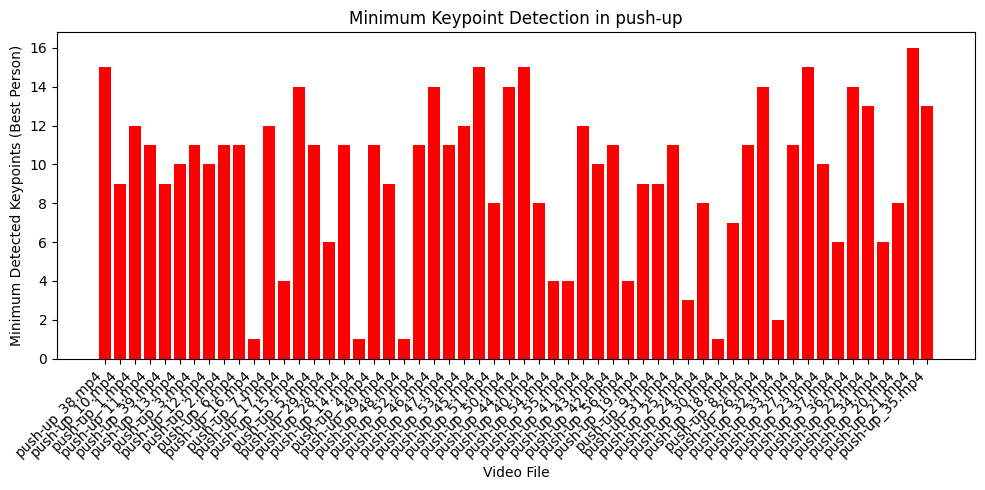


0: 384x640 1 person, 26.4ms
Speed: 1.0ms preprocess, 26.4ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.5ms
Speed: 0.9ms preprocess, 21.5ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.1ms
Speed: 1.6ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 17.9ms
Speed: 1.3ms preprocess, 17.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 17.3ms
Speed: 0.9ms preprocess, 17.3ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 17.9ms
Speed: 0.9ms preprocess, 17.9ms inference, 1.0ms postprocess per image at shape (1, 3, 38

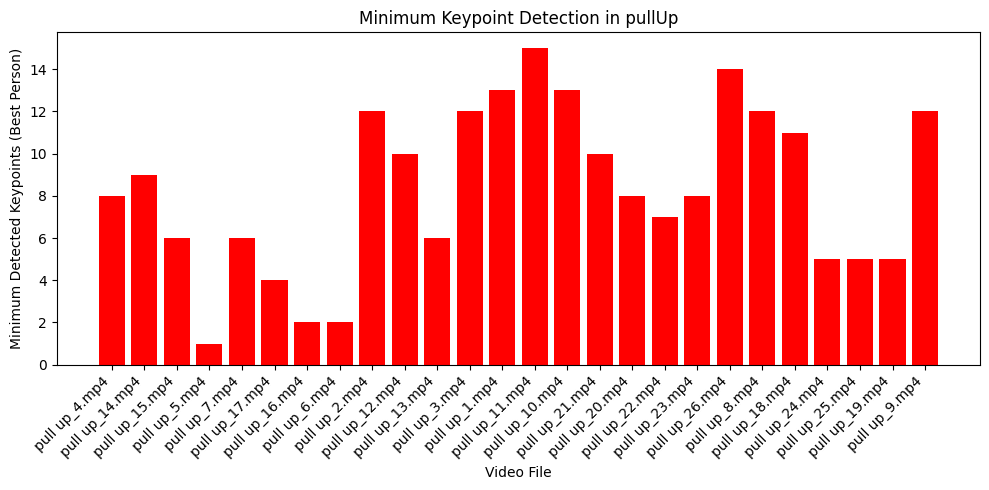


0: 384x640 1 person, 36.3ms
Speed: 1.0ms preprocess, 36.3ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 23.2ms
Speed: 0.8ms preprocess, 23.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 25.4ms
Speed: 0.7ms preprocess, 25.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.9ms
Speed: 0.8ms preprocess, 19.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.4ms
Speed: 0.7ms preprocess, 20.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.6ms
Speed: 0.7ms preprocess, 21.6ms inference, 0.3ms postprocess per image at shape (1, 3, 38

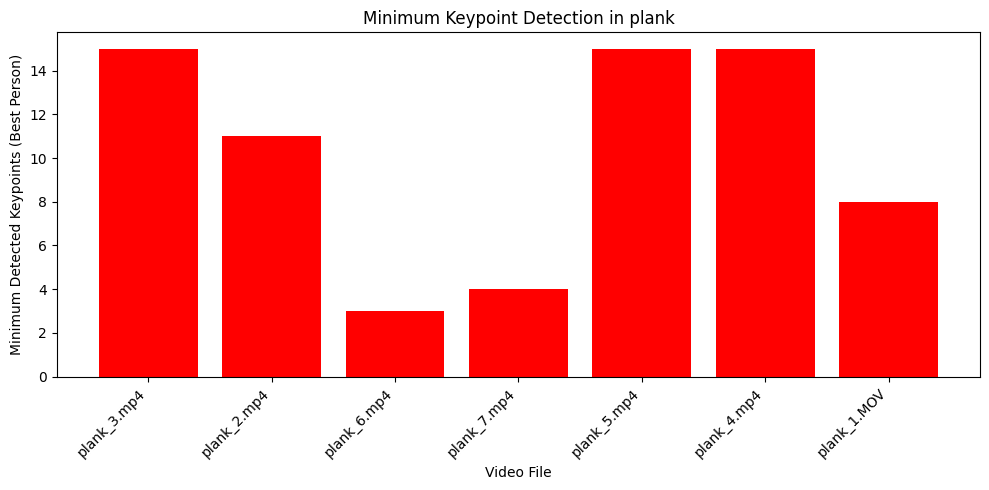


0: 384x640 2 persons, 19.0ms
Speed: 0.8ms preprocess, 19.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 19.3ms
Speed: 0.7ms preprocess, 19.3ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 21.9ms
Speed: 0.8ms preprocess, 21.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 16.3ms
Speed: 0.7ms preprocess, 16.3ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 17.3ms
Speed: 1.5ms preprocess, 17.3ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 18.9ms
Speed: 0.8ms preprocess, 18.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 persons, 22.9ms
Speed: 0.7ms preprocess, 22.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 18.0ms
Speed: 0.7ms preprocess, 18.0ms inference, 0.3ms postprocess per image at shape (

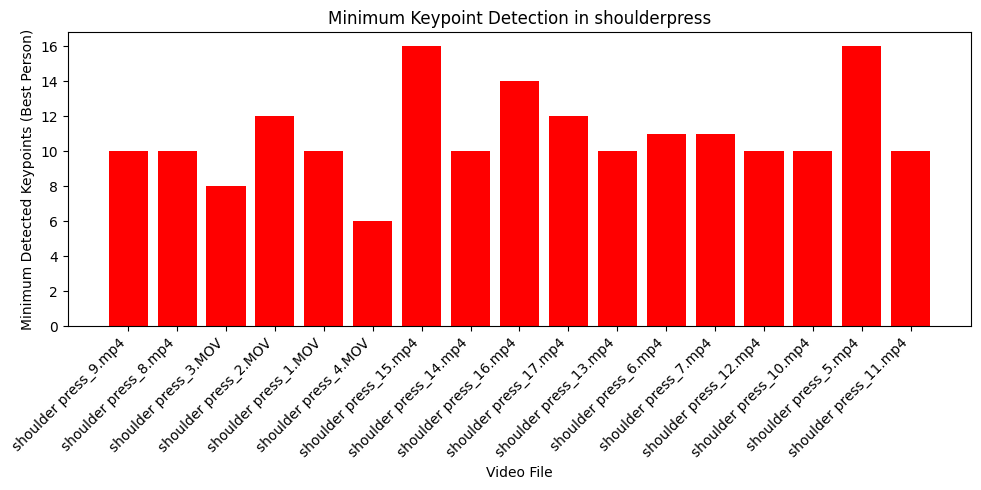


0: 384x640 1 person, 21.2ms
Speed: 1.7ms preprocess, 21.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.2ms
Speed: 0.7ms preprocess, 21.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.9ms
Speed: 0.7ms preprocess, 20.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 22.0ms
Speed: 0.8ms preprocess, 22.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.6ms
Speed: 0.8ms preprocess, 20.6ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.7ms
Speed: 1.3ms preprocess, 18.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.3ms
Speed: 0.7ms preprocess, 19.3ms inference, 0.3ms postprocess per image at shape (1, 3, 38

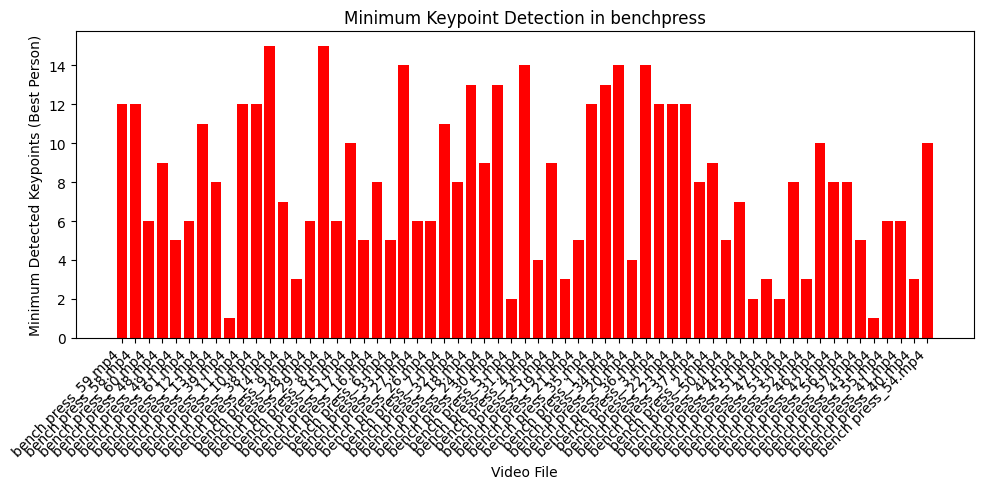


0: 384x640 1 person, 33.7ms
Speed: 2.0ms preprocess, 33.7ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.7ms
Speed: 0.9ms preprocess, 19.7ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.8ms
Speed: 0.7ms preprocess, 19.8ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.9ms
Speed: 0.9ms preprocess, 20.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 22.2ms
Speed: 0.9ms preprocess, 22.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.0ms
Speed: 0.7ms preprocess, 21.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 0.2ms postprocess per image at shape (1, 3, 38

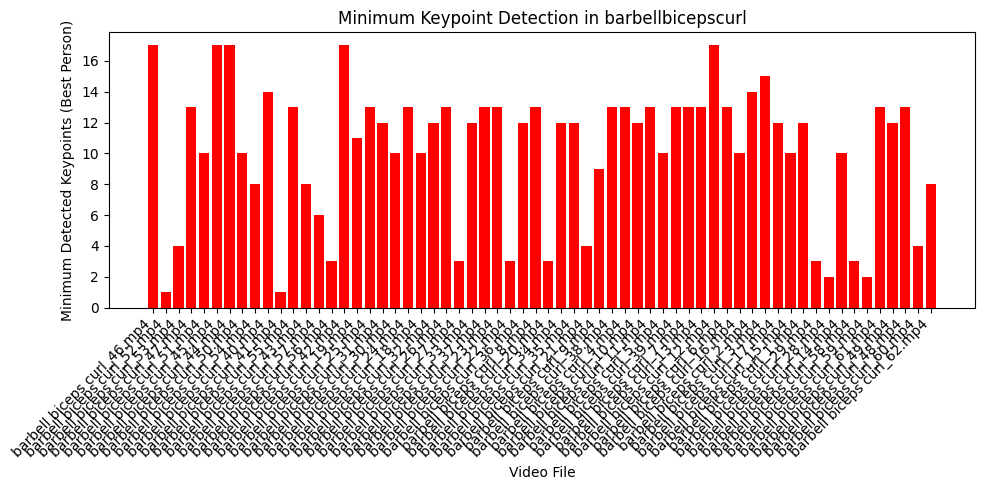


0: 384x640 1 person, 35.2ms
Speed: 1.0ms preprocess, 35.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 17.1ms
Speed: 1.0ms preprocess, 17.1ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.0ms
Speed: 0.9ms preprocess, 19.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.7ms
Speed: 0.9ms preprocess, 19.7ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 16.5ms
Speed: 0.9ms preprocess, 16.5ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.1ms
Speed: 0.9ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.3ms postprocess per image at shape (1, 3, 38

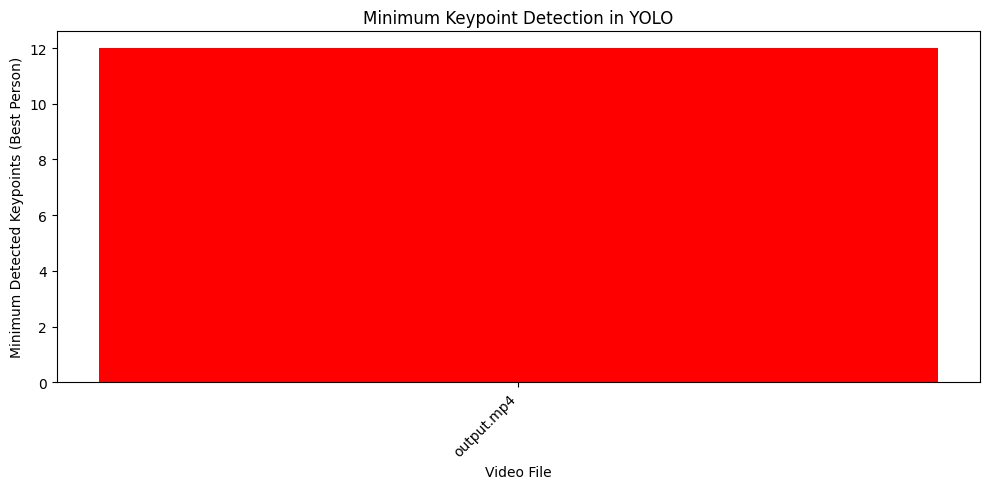

In [11]:
# Load YOLO model (Ensure you have YOLOv8 with pose detection)
model = YOLO("yolov8n-pose.pt")  

# Path to the main video directory
video_dir = "../Videos"  

# Process each folder inside the main directory
for folder in os.listdir(video_dir):
    folder_path = os.path.join(video_dir, folder)
    if not os.path.isdir(folder_path):
        continue  # Skip non-folder items

    video_data = {}  # Store video file names and minimum detected joint count

    # Process each video in the folder
    for video_file in os.listdir(folder_path):
        video_path = os.path.join(folder_path, video_file)
        if not video_file.lower().endswith((".mp4", ".avi", ".mov", ".mkv")):
            continue  # Skip non-video files

        cap = cv2.VideoCapture(video_path)
        min_keypoints = float("inf")  # Start with an infinitely large value
        frame_count = 0

        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break  # Stop if the video ends

            results = model(frame)  # Run YOLO pose estimation

            best_person_keypoints = 0  # Store the highest keypoints count in this frame

            for result in results:
                if hasattr(result, 'keypoints'):
                    keypoints = result.keypoints.xy.cpu().numpy()  # Extract keypoints
                    for person in keypoints:
                        person_keypoints = sum(1 for x, y in person if x > 0 and y > 0)  # Count valid keypoints

                        # Keep only the person with the most keypoints in this frame
                        if person_keypoints > best_person_keypoints:
                            best_person_keypoints = person_keypoints

            # Update the minimum keypoints count across all frames
            if best_person_keypoints < min_keypoints and best_person_keypoints > 0:
                min_keypoints = best_person_keypoints

            frame_count += 1

        cap.release()

        # Store the minimum keypoints detected in any frame of the video
        video_data[video_file] = min_keypoints if frame_count > 0 else 0

    # Plot results for the current folder
    if video_data:
        plt.figure(figsize=(10, 5))
        plt.bar(video_data.keys(), video_data.values(), color='red')
        plt.xlabel("Video File")
        plt.ylabel("Minimum Detected Keypoints (Best Person)")
        plt.title(f"Minimum Keypoint Detection in {folder}")
        plt.xticks(rotation=45, ha="right")
        plt.tight_layout()
        plt.show()

## Now we will create a new folder that will contain all the csv files of the detected keypoints for each video.

In [4]:

# Load your YOLOv8 pose model
model = YOLO("yolov8n-pose.pt")

# Roots
video_root     = "../Videos"
keypoints_root = "../Keypoints"
os.makedirs(keypoints_root, exist_ok=True)

# Regex for parsing folders
for folder in os.listdir(video_root):
    src_folder = os.path.join(video_root, folder)
    if not os.path.isdir(src_folder):
        continue

    dst_folder = os.path.join(keypoints_root, folder)
    os.makedirs(dst_folder, exist_ok=True)

    # Process each video
    for video_file in os.listdir(src_folder):
        if not video_file.lower().endswith((".mp4", ".avi", ".mov", ".mkv")):
            continue

        path = os.path.join(src_folder, video_file)
        cap  = cv2.VideoCapture(path)

        frame_kps   = []            # will hold a list of 17×2 arrays
        min_kps     = float("inf")
        pattern     = None  # not needed here, YOLO does parsing

        while True:
            ret, frame = cap.read()
            if not ret:
                break

            # Pose detection
            results = model(frame)

            best_count = 0
            best_coords = None

            # find the person with most valid keypoints
            for res in results:
                if hasattr(res, "keypoints"):
                    coords = res.keypoints.xy.cpu().numpy()  # shape=(n_people,17,2)
                    for person in coords:
                        valid = int(np.sum((person > 0).all(axis=1)))
                        if valid > best_count:
                            best_count  = valid
                            best_coords = person

            # record
            if best_coords is not None:
                frame_kps.append(best_coords)
                min_kps = min(min_kps, best_count)
            else:
                # if no person detected, pad with zeros (or None)
                frame_kps.append(np.zeros((17,2), dtype=float))
                min_kps = 0

        cap.release()

        # if this video never dropped below 6 keypoints, save its data
        if min_kps >= 6 and frame_kps:
            out_path = os.path.join(dst_folder, os.path.splitext(video_file)[0] + ".npz")
            np.savez_compressed(out_path, keypoints=np.stack(frame_kps, axis=0))
            print(f"Saved keypoints for '{video_file}' → '{out_path}' (min_kps={min_kps})")


0: 384x640 1 person, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 17.9ms
Speed: 1.0ms preprocess, 17.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.3ms
Speed: 1.0ms preprocess, 18.3ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.5ms
Speed: 1.5ms preprocess, 18.5ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 16.4ms
Speed: 1.0ms preprocess, 16.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 15.9ms
Speed: 0.9ms preprocess, 15.9ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 19.0ms
Speed: 0.8ms preprocess, 19.0ms inference, 0.3ms postprocess per image at shape (1, 3, 38

### Now that we have all usable csv, we want to try and see the balance in the data set in terms of videos per exercise, and therefore available data for training a potential model.

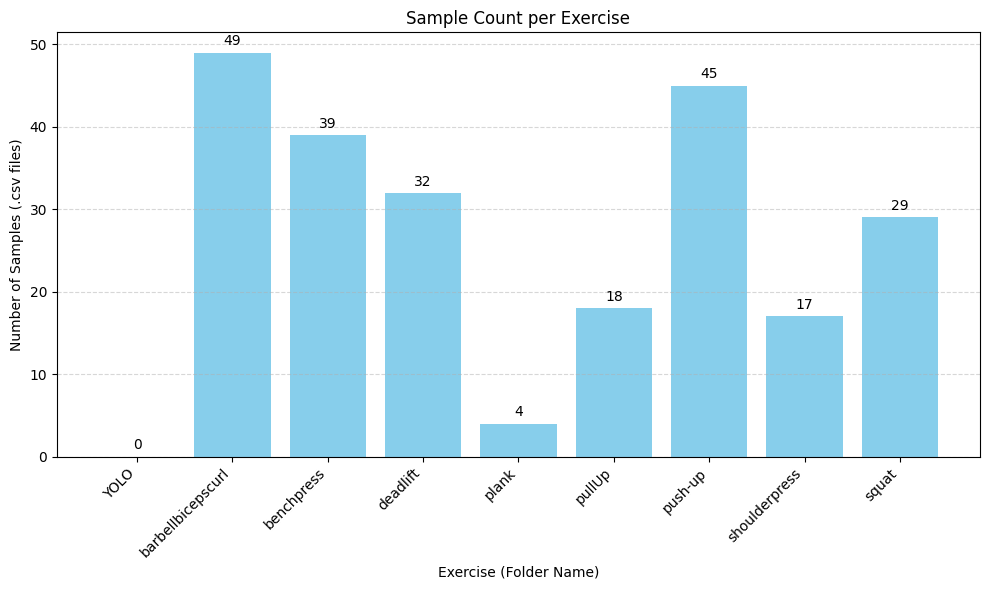

In [5]:
def plot_sample_counts(root_dir="../KeypointsCSV"):
    # Gather counts
    labels = []
    counts = []
    for folder in sorted(os.listdir(root_dir)):
        folder_path = os.path.join(root_dir, folder)
        if not os.path.isdir(folder_path):
            continue
        # count only .csv files
        n_csv = sum(1 for f in os.listdir(folder_path)
                    if f.lower().endswith(".csv"))
        labels.append(folder)
        counts.append(n_csv)

    # Plot
    plt.figure(figsize=(10, 6))
    bars = plt.bar(labels, counts, color='skyblue')
    plt.xlabel("Exercise (Folder Name)")
    plt.ylabel("Number of Samples (.csv files)")
    plt.title("Sample Count per Exercise")
    plt.xticks(rotation=45, ha="right")
    plt.grid(axis='y', linestyle='--', alpha=0.5)

    # Annotate bars with counts
    for bar, count in zip(bars, counts):
        plt.text(
            bar.get_x() + bar.get_width()/2,
            bar.get_height() + 0.5,
            str(count),
            ha='center',
            va='bottom'
        )

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    plot_sample_counts("../KeypointsCSV")

### We’ve noticed that some exercises (for example, plank) contain far less videos than others (like biceps curls or push-ups). If we train on this unbalanced dataset, the model will see—and learn from—certain classes much more often, making it better at recognizing those and worse at the under-represented ones. To prevent this bias, we need to:
#### 1.	Count the total frames for each exercise.
#### 2.	Identify large discrepancies.
#### 3.	Resample (down-sample or up-sample) so that every exercise ends up with a similar frame count.

### This way, each class is equally represented and our classifier won’t be skewed toward the exercises with the most data.

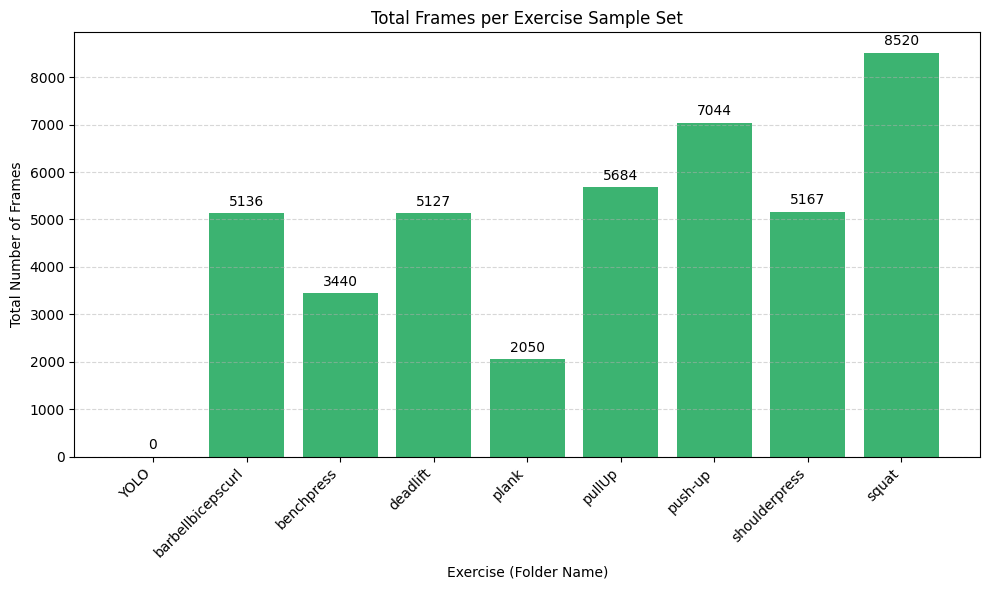

In [6]:
def plot_total_frames(root_dir="../KeypointsCSV"):
    labels = []
    totals = []

    # Iterate over each exercise folder
    for folder in sorted(os.listdir(root_dir)):
        folder_path = os.path.join(root_dir, folder)
        if not os.path.isdir(folder_path):
            continue

        total_frames = 0
        # Sum the number of rows (frames) in every CSV
        for fname in os.listdir(folder_path):
            if not fname.lower().endswith(".csv"):
                continue
            csv_path = os.path.join(folder_path, fname)
            df = pd.read_csv(csv_path)
            # assume each row is one frame; drop header row count
            total_frames += len(df)

        labels.append(folder)
        totals.append(total_frames)

    # Plotting
    plt.figure(figsize=(10, 6))
    bars = plt.bar(labels, totals, color="mediumseagreen")
    plt.xlabel("Exercise (Folder Name)")
    plt.ylabel("Total Number of Frames")
    plt.title("Total Frames per Exercise Sample Set")
    plt.xticks(rotation=45, ha="right")
    plt.grid(axis="y", linestyle="--", alpha=0.5)

    # Annotate bars with totals
    for bar, total in zip(bars, totals):
        plt.text(
            bar.get_x() + bar.get_width() / 2,
            bar.get_height() + max(totals)*0.01,
            str(total),
            ha="center",
            va="bottom"
        )

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    plot_total_frames("../KeypointsCSV")

### We’ve determined that around 5,100 frames per exercise strikes the right balance. Now we need to adjust each class’s data so that it’s as close to this target as possible. Because every exercise sample is a continuous time series (i.e. one full repetition), we must resample at the repetition level—duplicating or dropping entire sequences—rather than randomly selecting individual frames. This preserves the temporal structure that’s essential for our model to learn each movement correctly.

In [7]:
# Configuration
SRC_ROOT    = "../KeypointsCSV"
DST_ROOT    = "../BalancedKeypointsCSV"
TARGET_FR   = 5100   # target total frames per class

os.makedirs(DST_ROOT, exist_ok=True)

for exercise in sorted(os.listdir(SRC_ROOT)):
    src_folder = os.path.join(SRC_ROOT, exercise)
    if not os.path.isdir(src_folder):
        continue

    # read frame-counts for each CSV
    file_counts = {}
    for fname in os.listdir(src_folder):
        if not fname.lower().endswith(".csv"):
            continue
        path = os.path.join(src_folder, fname)
        df = pd.read_csv(path)
        file_counts[fname] = len(df)

    files = list(file_counts.keys())
    if not files:
        continue

    # select files (with replacement) until total >= TARGET_FR
    selected = []
    total = 0
    while total < TARGET_FR:
        pick = random.choice(files)
        selected.append(pick)
        total += file_counts[pick]

    # maybe drop last pick if it gets closer to TARGET_FR
    overshoot = abs(total - TARGET_FR)
    undershoot = abs((total - file_counts[selected[-1]]) - TARGET_FR)
    if undershoot < overshoot:
        total -= file_counts[selected[-1]]
        selected.pop()

    print(f"{exercise}: selected {len(selected)} files → {total} frames")

    # tally how many times each file appears
    counts = {}
    for f in selected:
        counts[f] = counts.get(f, 0) + 1

    # copy into DST_ROOT, repeating as needed
    dst_folder = os.path.join(DST_ROOT, exercise)
    os.makedirs(dst_folder, exist_ok=True)

    for fname, reps in counts.items():
        src_path = os.path.join(src_folder, fname)
        base, ext = os.path.splitext(fname)
        for i in range(reps):
            # name duplicates with _rep0, _rep1, …
            dst_name = f"{base}_rep{i}{ext}"
            dst_path = os.path.join(dst_folder, dst_name)
            shutil.copy2(src_path, dst_path)

barbellbicepscurl: selected 47 files → 5109 frames
benchpress: selected 56 files → 5037 frames
deadlift: selected 35 files → 5110 frames
plank: selected 12 files → 4800 frames
pullUp: selected 12 files → 5032 frames
push-up: selected 36 files → 5070 frames
shoulderpress: selected 14 files → 5008 frames
squat: selected 20 files → 5066 frames


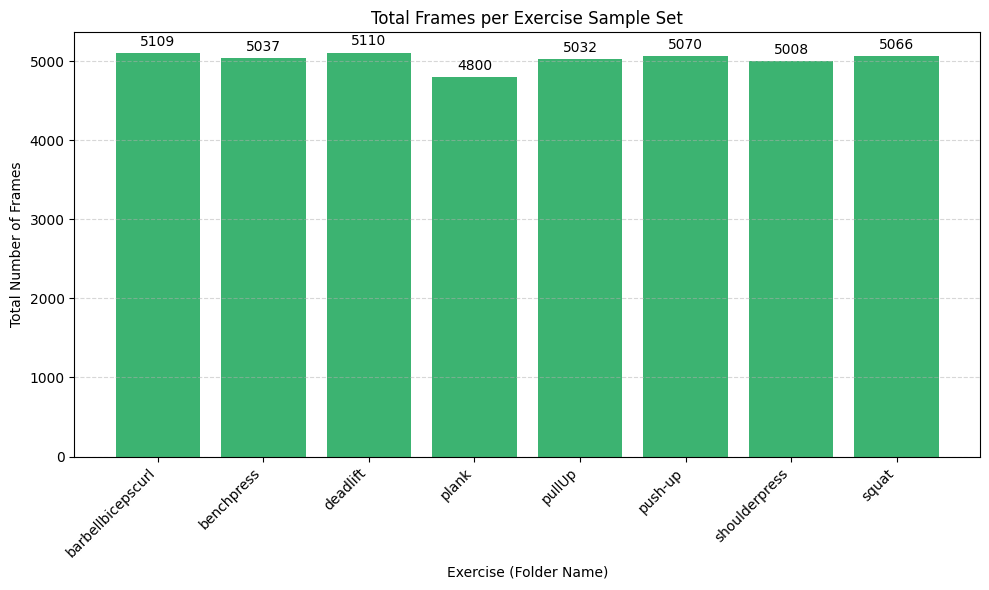

In [11]:
import os
import pandas as pd
import matplotlib.pyplot as plt

def plot_total_frames(root_dir="../BalancedKeypointsCSV"):
    labels = []
    totals = []

    # Iterate over each exercise folder
    for folder in sorted(os.listdir(root_dir)):
        folder_path = os.path.join(root_dir, folder)
        if not os.path.isdir(folder_path):
            continue

        total_frames = 0
        # Sum the number of rows (frames) in every CSV
        for fname in os.listdir(folder_path):
            if not fname.lower().endswith(".csv"):
                continue
            csv_path = os.path.join(folder_path, fname)
            df = pd.read_csv(csv_path)
            # assume each row is one frame; drop header row count
            total_frames += len(df)

        labels.append(folder)
        totals.append(total_frames)

    # Plotting
    plt.figure(figsize=(10, 6))
    bars = plt.bar(labels, totals, color="mediumseagreen")
    plt.xlabel("Exercise (Folder Name)")
    plt.ylabel("Total Number of Frames")
    plt.title("Total Frames per Exercise Sample Set")
    plt.xticks(rotation=45, ha="right")
    plt.grid(axis="y", linestyle="--", alpha=0.5)

    # Annotate bars with totals
    for bar, total in zip(bars, totals):
        plt.text(
            bar.get_x() + bar.get_width() / 2,
            bar.get_height() + max(totals)*0.01,
            str(total),
            ha="center",
            va="bottom"
        )

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    plot_total_frames("../BalancedKeypointsCSV")

### The data set now seems to be extremely well balanced. It's time to check for correlation on each individual feature

In [14]:
# Input and output paths
SRC_ROOT   = "../BalancedKeypointsCSV"
OUTPUT_DIR = "../ProcessedData"
OUTPUT_CSV = os.path.join(OUTPUT_DIR, "all_data.csv")

# Make sure output directory exists
os.makedirs(OUTPUT_DIR, exist_ok=True)

all_dfs = []

# Enumerate exercise folders and assign class IDs
for class_id, folder in enumerate(sorted(os.listdir(SRC_ROOT)), start=1):
    folder_path = os.path.join(SRC_ROOT, folder)
    if not os.path.isdir(folder_path):
        continue

    # Read each CSV in the folder
    for fname in sorted(os.listdir(folder_path)):
        if not fname.lower().endswith(".csv"):
            continue

        file_path = os.path.join(folder_path, fname)
        df = pd.read_csv(file_path)

        # Annotate with metadata
        df["source_file"] = fname
        df["class_id"]    = class_id

        all_dfs.append(df)

# Concatenate everything into one DataFrame
if all_dfs:
    merged = pd.concat(all_dfs, ignore_index=True)
    merged.to_csv(OUTPUT_CSV, index=False)
    print(f"Saved combined data ({len(all_dfs)} files) to:\n  {OUTPUT_CSV}")
else:
    print(f"No CSV files found in {SRC_ROOT}")

Saved combined data (232 files) to:
  ../ProcessedData/all_data.csv


Correlation matrix:
              frame        x0        y0        x1        y1        x2  \
frame     1.000000 -0.009564  0.000534 -0.052959 -0.012132 -0.028518   
x0       -0.009564  1.000000  0.548059  0.600924  0.298192  0.796983   
y0        0.000534  0.548059  1.000000  0.305983  0.752843  0.309604   
x1       -0.052959  0.600924  0.305983  1.000000  0.603634  0.551497   
y1       -0.012132  0.298192  0.752843  0.603634  1.000000  0.194244   
x2       -0.028518  0.796983  0.309604  0.551497  0.194244  1.000000   
y2        0.012020  0.568334  0.621677  0.408897  0.485510  0.730808   
x3       -0.140498  0.215077  0.090395  0.561679  0.326031  0.167829   
y3       -0.092806  0.006243  0.484064  0.275565  0.678795 -0.072784   
x4        0.033317  0.505039  0.070620  0.186140 -0.082101  0.621828   
y4        0.035082  0.408939  0.273280  0.169009  0.095579  0.498825   
x5        0.111360  0.607355  0.245849  0.360422  0.096940  0.543517   
y5       -0.010255  0.213148  0.704005  0.1

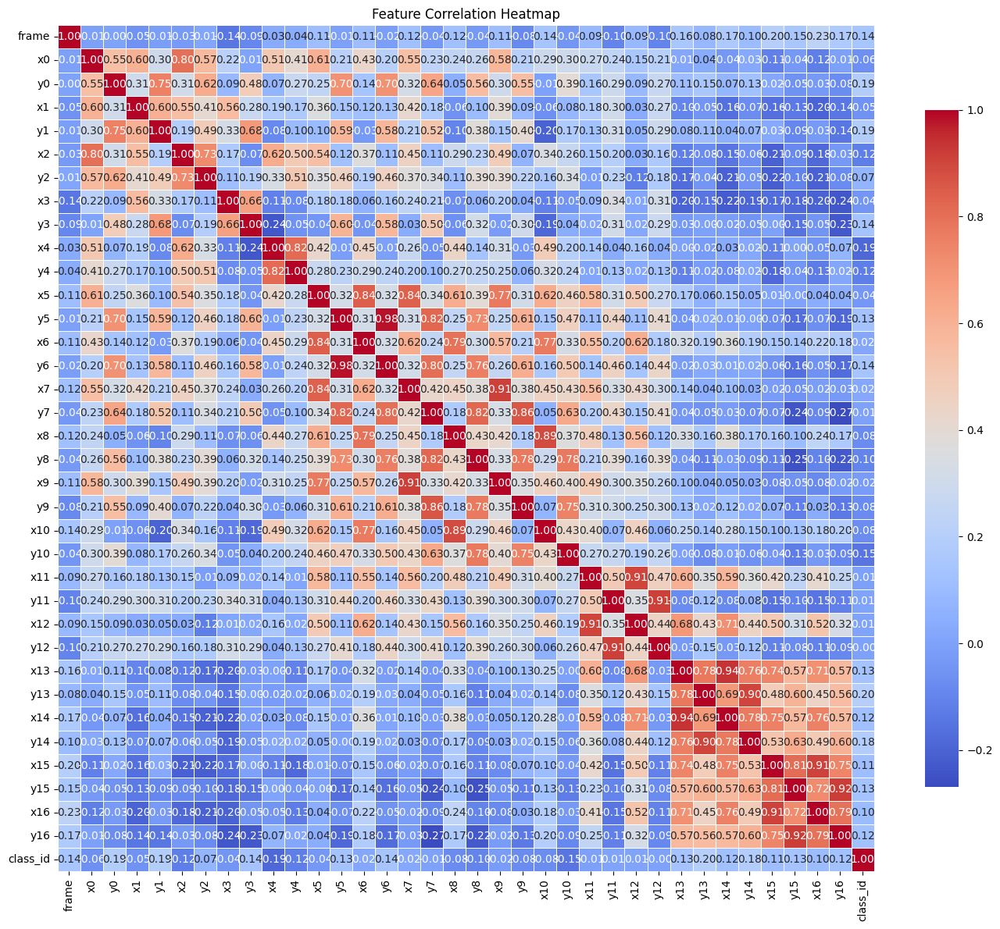

In [15]:


# Path to your merged dataset
file_path = "../ProcessedData/all_data.csv"

# 1) Load the full dataset
df = pd.read_csv(file_path)

# 2) Select only numeric columns
#    This will include: frame (if numeric), all x0,y0...x16,y16, class_id
df_numeric = df.select_dtypes(include="number")

# 3) Compute correlation matrix
corr = df_numeric.corr()

# 4) Print it out
print("Correlation matrix:\n", corr)

# 5) Plot as heatmap
plt.figure(figsize=(14, 12))
sns.heatmap(
    corr,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    linewidths=0.5,
    cbar_kws={"shrink": .8}
)
plt.title("Feature Correlation Heatmap")
plt.tight_layout()
plt.show()

### There seems to be a great correlation (above 0.8) in a lot of features, to simplify and better visualize this, we decided to print out each pair of correlation and determine the importance of each.

In [16]:
# Path to your merged dataset
FILE_PATH = "../ProcessedData/all_data.csv"
THRESHOLD = 0.83

# COCO 17‐keypoint mapping
KEYPOINT_MAP = {
    '0': 'nose',
    '1': 'left eye',
    '2': 'right eye',
    '3': 'left ear',
    '4': 'right ear',
    '5': 'left shoulder',
    '6': 'right shoulder',
    '7': 'left elbow',
    '8': 'right elbow',
    '9': 'left wrist',
    '10': 'right wrist',
    '11': 'left hip',
    '12': 'right hip',
    '13': 'left knee',
    '14': 'right knee',
    '15': 'left ankle',
    '16': 'right ankle'
}

# Regex to detect coordinate columns like x0, y5, etc.
coord_re = re.compile(r'^([xy])(\d+)$')

def map_feature(col):
    """Return the human‐readable body part for a coordinate column."""
    m = coord_re.match(col)
    if not m:
        return None
    idx = m.group(2)
    return KEYPOINT_MAP.get(idx, f"kp{idx}")

# 1) Load data
df = pd.read_csv(FILE_PATH)

# 2) Select only the coordinate columns (x0,y0,...,x16,y16)
coords = [c for c in df.columns if coord_re.match(c)]

# 3) Compute correlation matrix on those columns
corr = df[coords].corr()

# 4) Find and print highly correlated pairs
print(f"Pairs with |corr| ≥ {THRESHOLD}:\n")
n = len(coords)
for i in range(n):
    for j in range(i):
        r = corr.iat[i, j]
        if abs(r) >= THRESHOLD:
            c1 = coords[i]
            c2 = coords[j]
            p1 = map_feature(c1)
            p2 = map_feature(c2)
            print(f"{c1:4s} ({p1:15s}) ⟷ {c2:4s} ({p2:15s}) : corr = {r:.2f}")

Pairs with |corr| ≥ 0.83:

x6   (right shoulder ) ⟷ x5   (left shoulder  ) : corr = 0.84
y6   (right shoulder ) ⟷ y5   (left shoulder  ) : corr = 0.98
x7   (left elbow     ) ⟷ x5   (left shoulder  ) : corr = 0.84
x9   (left wrist     ) ⟷ x7   (left elbow     ) : corr = 0.91
y9   (left wrist     ) ⟷ y7   (left elbow     ) : corr = 0.86
x10  (right wrist    ) ⟷ x8   (right elbow    ) : corr = 0.89
x12  (right hip      ) ⟷ x11  (left hip       ) : corr = 0.91
y12  (right hip      ) ⟷ y11  (left hip       ) : corr = 0.91
x14  (right knee     ) ⟷ x13  (left knee      ) : corr = 0.94
y14  (right knee     ) ⟷ y13  (left knee      ) : corr = 0.90
x16  (right ankle    ) ⟷ x15  (left ankle     ) : corr = 0.91
y16  (right ankle    ) ⟷ y15  (left ankle     ) : corr = 0.92


### The correlation is now clear, but we also though that each feature makes sense as coordinate more then an individual. We therefore created a python script to check for correlation between coordinates and not single features for each keypoint.

## Task 1


Correlation matrix among joint‐radii:
            r0        r1        r2        r3        r4        r5        r6  \
r0   1.000000  0.591968  0.740832  0.203254  0.433198  0.578573  0.426341   
r1   0.591968  1.000000  0.503611  0.552626  0.129365  0.336160  0.138314   
r2   0.740832  0.503611  1.000000  0.121537  0.592631  0.495308  0.336900   
r3   0.203254  0.552626  0.121537  1.000000 -0.147857  0.192876  0.101165   
r4   0.433198  0.129365  0.592631 -0.147857  1.000000  0.356111  0.370582   
r5   0.578573  0.336160  0.495308  0.192876  0.356111  1.000000  0.875054   
r6   0.426341  0.138314  0.336900  0.101165  0.370582  0.875054  1.000000   
r7   0.537985  0.401872  0.400630  0.254593  0.188717  0.826090  0.648998   
r8   0.290313 -0.000612  0.297417 -0.015941  0.387874  0.672805  0.770705   
r9   0.557190  0.359636  0.399948  0.175233  0.213085  0.746244  0.582462   
r10  0.305823 -0.037462  0.354582 -0.118229  0.440444  0.651982  0.700638   
r11  0.295818  0.250681  0.162946  0.

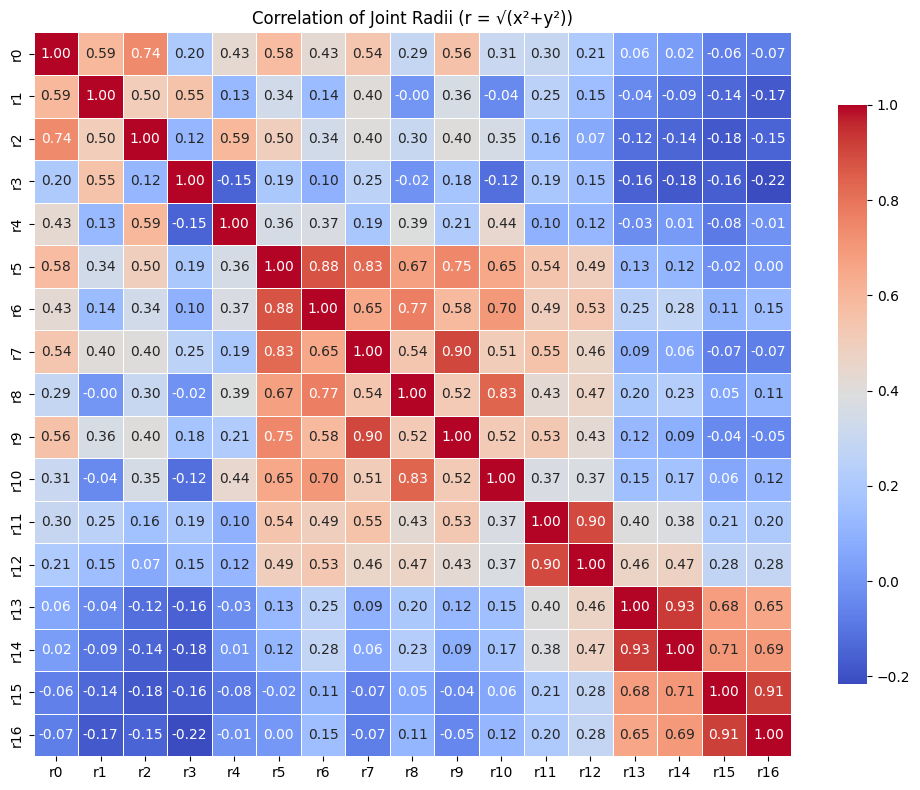

In [17]:
# Path to your merged dataset
FILE_PATH = "../ProcessedData/all_data.csv"

# Load
df = pd.read_csv(FILE_PATH)

# Build radius columns r0…r16
radii = {}
for j in range(17):
    xcol = f"x{j}"
    ycol = f"y{j}"
    if xcol in df.columns and ycol in df.columns:
        radii[f"r{j}"] = np.hypot(df[xcol], df[ycol])

r_df = pd.DataFrame(radii)

# Compute correlation matrix
corr = r_df.corr()

# Print
print("Correlation matrix among joint‐radii:\n", corr)

# Heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(
    corr,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    xticklabels=corr.columns,
    yticklabels=corr.columns,
    linewidths=0.5,
    cbar_kws={"shrink":0.8}
)
plt.title("Correlation of Joint Radii (r = √(x²+y²))")
plt.tight_layout()
plt.show()

### Again there seems to be a similar level of correlation, and to better visualize it we are going to print once more the correlation between coordinates, naming what that coordinate rapresents as area of the body.

In [ ]:
# Path to merged data
FILE_PATH = "../ProcessedData/all_data.csv"
THRESHOLD = 0.83

# COCO keypoint mapping
KEYPOINT_MAP = {
    '0': 'nose', '1': 'left eye', '2': 'right eye', '3': 'left ear', '4': 'right ear',
    '5': 'left shoulder', '6': 'right shoulder', '7': 'left elbow', '8': 'right elbow',
    '9': 'left wrist', '10': 'right wrist', '11': 'left hip', '12': 'right hip',
    '13': 'left knee', '14': 'right knee', '15': 'left ankle', '16': 'right ankle'
}

# Load full dataset
df = pd.read_csv(FILE_PATH)

# Build a DataFrame of radii r0…r16
radii = {}
for j in range(17):
    xcol = f"x{j}"
    ycol = f"y{j}"
    if xcol in df.columns and ycol in df.columns:
        radii[f"r{j}"] = np.hypot(df[xcol], df[ycol])
r_df = pd.DataFrame(radii)

# Compute the correlation matrix
corr = r_df.corr()

# Print out highly correlated radius‐pairs
print(f"Joint‐radius pairs with |corr| ≥ {THRESHOLD}:\n")
cols = list(corr.columns)
n = len(cols)
for i in range(n):
    for j in range(i):
        r_val = corr.iat[i, j]
        if abs(r_val) >= THRESHOLD:
            ci = cols[i]  # e.g. 'r5'
            cj = cols[j]
            idx_i = ci[1:]  # '5'
            idx_j = cj[1:]
            name_i = KEYPOINT_MAP[idx_i]
            name_j = KEYPOINT_MAP[idx_j]
            print(f"{ci:3s} ({name_i:15s}) ⟷ {cj:3s} ({name_j:15s}) : corr = {r_val:.2f}")

Joint‐radius pairs with |corr| ≥ 0.83:

r6  (right shoulder ) ⟷ r5  (left shoulder  ) : corr = 0.88
r9  (left wrist     ) ⟷ r7  (left elbow     ) : corr = 0.90
r10 (right wrist    ) ⟷ r8  (right elbow    ) : corr = 0.83
r12 (right hip      ) ⟷ r11 (left hip       ) : corr = 0.90
r14 (right knee     ) ⟷ r13 (left knee      ) : corr = 0.93
r16 (right ankle    ) ⟷ r15 (left ankle     ) : corr = 0.91


### We now know we can drop 6 coordinates, and we chose which one to drop based on the value of each coordinate using a randomforestclassifier to evaluete the influence of each feature on the model.

In [ ]:
# 1) Load merged data
FILE = "../ProcessedData/all_data.csv"
df   = pd.read_csv(FILE)

# 2) Build radii r0…r16
radii = {}
for j in range(17):
    xcol, ycol = f"x{j}", f"y{j}"
    if xcol in df.columns and ycol in df.columns:
        radii[f"r{j}"] = np.hypot(df[xcol], df[ycol])
r_df = pd.DataFrame(radii)

# 3) Find correlated pairs ≥ threshold
TH = 0.83
corr = r_df.corr().abs()
pairs = []
cols  = corr.columns
for i in range(len(cols)):
    for j in range(i):
        if corr.iat[i,j] >= TH:
            pairs.append((cols[i], cols[j], corr.iat[i,j]))

# 4) Train a RandomForest on the full dataset
X = r_df.values
y = df["class_id"].values
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X, y)

# 5) Extract importances
importances = dict(zip(r_df.columns, rf.feature_importances_))

# 6) Report for each pair which to drop (lower importance)
print("Highly correlated pairs (|r| ≥ {:.2f}) and lower-importance feature:\n".format(TH))
for a, b, r_val in pairs:
    ia, ib = importances[a], importances[b]
    drop = a if ia < ib else b
    print(f"{a:3s} ⟷ {b:3s}  corr={r_val:.2f}  |  imp({a})={ia:.4f}, imp({b})={ib:.4f} → drop `{drop}`")

Highly correlated pairs (|r| ≥ 0.83) and lower-importance feature:

r6  ⟷ r5   corr=0.88  |  imp(r6)=0.0587, imp(r5)=0.0448 → drop `r5`
r9  ⟷ r7   corr=0.90  |  imp(r9)=0.0841, imp(r7)=0.0550 → drop `r7`
r10 ⟷ r8   corr=0.83  |  imp(r10)=0.0666, imp(r8)=0.0471 → drop `r8`
r12 ⟷ r11  corr=0.90  |  imp(r12)=0.0555, imp(r11)=0.0613 → drop `r12`
r14 ⟷ r13  corr=0.93  |  imp(r14)=0.0585, imp(r13)=0.0662 → drop `r14`
r16 ⟷ r15  corr=0.91  |  imp(r16)=0.0815, imp(r15)=0.0638 → drop `r15`


### We created a new csv with the balanced data, without correlated features that can be used to start training, testing and validating a potential model.

In [ ]:
# paths
INPUT_CSV  = "../ProcessedData/all_data.csv"
OUTPUT_DIR = "../ProcessedData"
OUTPUT_CSV = os.path.join(OUTPUT_DIR, "uncorrelated_reduced_data.csv")

# which joint‐radii were marked to drop:
#   r5, r7, r8, r12, r14, r15
drop_joints = {"5", "7", "8", "12", "14", "15"}

# load full dataset
df = pd.read_csv(INPUT_CSV)

# build list of columns to drop: xj and yj for each dropped joint j
coord_re = re.compile(r'^([xy])(\d+)$')
to_drop = []
for col in df.columns:
    m = coord_re.match(col)
    if m and m.group(2) in drop_joints:
        to_drop.append(col)

# drop them
df_uncor = df.drop(columns=to_drop)

# save
os.makedirs(OUTPUT_DIR, exist_ok=True)
df_uncor.to_csv(OUTPUT_CSV, index=False)
print(f"Dropped joints {sorted(drop_joints)} → saved to:\n  {OUTPUT_CSV}")

Dropped joints ['12', '14', '15', '5', '7', '8'] → saved to:
  ../ProcessedData/uncorrelated_reduced_data.csv


Correlation matrix among joint‐radii:
            r0        r1        r2        r3        r4        r6        r9  \
r0   1.000000  0.591968  0.740832  0.203254  0.433198  0.426341  0.557190   
r1   0.591968  1.000000  0.503611  0.552626  0.129365  0.138314  0.359636   
r2   0.740832  0.503611  1.000000  0.121537  0.592631  0.336900  0.399948   
r3   0.203254  0.552626  0.121537  1.000000 -0.147857  0.101165  0.175233   
r4   0.433198  0.129365  0.592631 -0.147857  1.000000  0.370582  0.213085   
r6   0.426341  0.138314  0.336900  0.101165  0.370582  1.000000  0.582462   
r9   0.557190  0.359636  0.399948  0.175233  0.213085  0.582462  1.000000   
r10  0.305823 -0.037462  0.354582 -0.118229  0.440444  0.700638  0.518576   
r11  0.295818  0.250681  0.162946  0.191226  0.101189  0.493081  0.528527   
r13  0.064592 -0.039579 -0.119320 -0.155573 -0.027025  0.254361  0.122679   
r16 -0.072241 -0.173846 -0.147640 -0.215514 -0.012999  0.149483 -0.049308   

          r10       r11       r13   

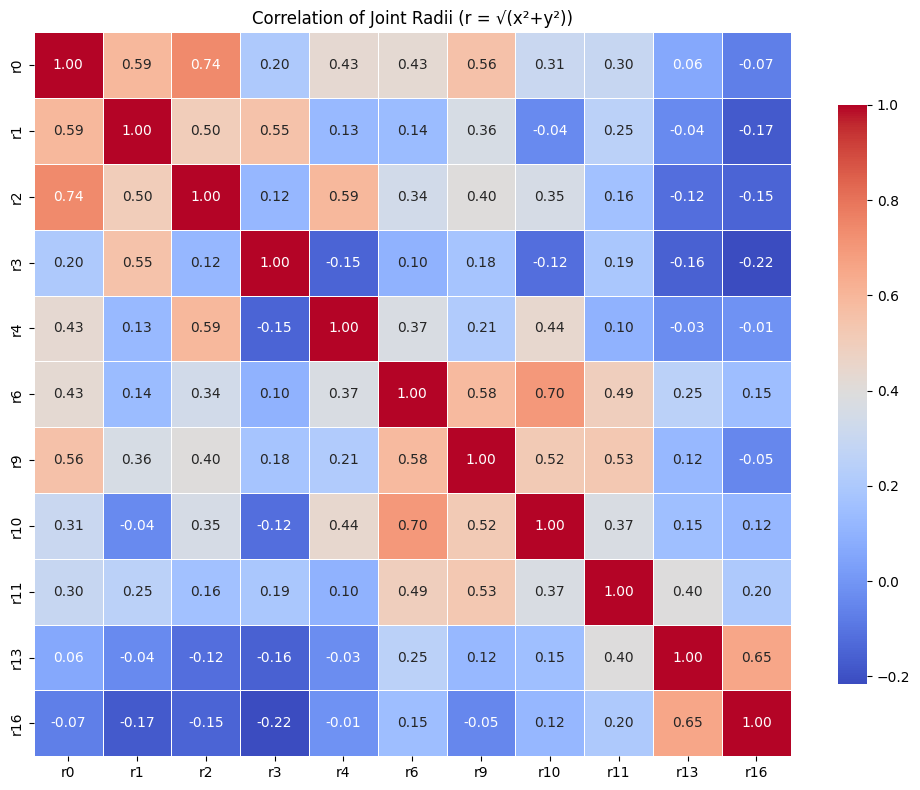

In [26]:
# Path to your merged dataset
FILE_PATH = "../ProcessedData/uncorrelated_reduced_data.csv"

# Load
df = pd.read_csv(FILE_PATH)

# Build radius columns r0…r16
radii = {}
for j in range(17):
    xcol = f"x{j}"
    ycol = f"y{j}"
    if xcol in df.columns and ycol in df.columns:
        radii[f"r{j}"] = np.hypot(df[xcol], df[ycol])

r_df = pd.DataFrame(radii)

# Compute correlation matrix
corr = r_df.corr()

# Print
print("Correlation matrix among joint‐radii:\n", corr)

# Heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(
    corr,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    xticklabels=corr.columns,
    yticklabels=corr.columns,
    linewidths=0.5,
    cbar_kws={"shrink":0.8}
)
plt.title("Correlation of Joint Radii (r = √(x²+y²))")
plt.tight_layout()
plt.show()

When doing ksplits we want to keep each source_file (repetition) intact by using group‐aware splits. All windows drawn from one file will go entirely into train, val, or test.

In [2]:
# ---- PARAMETERS ----
FILE_PATH    = "../ProcessedData/uncorrelated_reduced_data.csv"
TIME_STEPS   = 50    # frames per window
STRIDE       = 25    # window stride
TEST_SIZE    = 0.2   # final test fraction
VAL_SIZE     = 0.25  # fraction *of the remaining* for validation (→ 0.2 of total)
RANDOM_STATE = 42

batch_sizes = [8, 16, 32, 64]
epoch_sizes = [5, 10, 20,40,80,160]

# ---- 1) LOAD & PREPARE GROUP‐AWARE WINDOWS ----
df = pd.read_csv(FILE_PATH)
df["file_id"] = df["source_file"].astype("category").cat.codes
groups = df["file_id"].values

# features + zero‐indexed labels
drop_cols    = ["frame", "source_file", "class_id", "file_id"]
feature_cols = [c for c in df.columns if c not in drop_cols]
X_raw        = df[feature_cols].values
y_raw        = df["class_id"].astype(int).values - 1

# standardize
scaler   = StandardScaler()
X_scaled = scaler.fit_transform(X_raw)

# windowing
def create_windows(X, y, g, ts, stride):
    Xs, ys, grp = [], [], []
    n = len(X)
    for start in range(0, n - ts + 1, stride):
        end = start + ts
        if np.all(g[start:end] == g[start]):
            Xs.append(X[start:end])
            ys.append(y[end-1])
            grp.append(g[start])
    return np.array(Xs), np.array(ys), np.array(grp)

X_seq, y_seq, grp_seq = create_windows(X_scaled, y_raw, groups, TIME_STEPS, STRIDE)
num_classes = int(y_seq.max() + 1)

# ---- 2) STRATIFIED‐GROUP SPLIT → train_val / test ----
outer_cv = StratifiedGroupKFold(
    n_splits=int(1/TEST_SIZE), shuffle=True, random_state=RANDOM_STATE
)
tv_idx, test_idx = next(outer_cv.split(X_seq, y_seq, groups=grp_seq))
X_tv,   X_test   = X_seq[tv_idx],   X_seq[test_idx]
y_tv,   y_test   = y_seq[tv_idx],   y_seq[test_idx]
grp_tv, grp_test = grp_seq[tv_idx], grp_seq[test_idx]

# ---- 3) STRATIFIED‐GROUP SPLIT → train / val ----
inner_cv = StratifiedGroupKFold(
    n_splits=int(1/VAL_SIZE), shuffle=True, random_state=RANDOM_STATE
)
train_idx, val_idx = next(inner_cv.split(X_tv, y_tv, groups=grp_tv))
X_train, X_val = X_tv[train_idx], X_tv[val_idx]
y_train, y_val = y_tv[train_idx], y_tv[val_idx]

# Check class balance
for name, y in [("Train", y_train), ("Val", y_val), ("Test", y_test)]:
    counts = np.bincount(y, minlength=num_classes)
    freqs  = counts / counts.sum()
    print(f"{name} class counts: {counts}")
    print(f"{name} class freqs:  {freqs.round(3)}\n")


Train class counts: [ 60  50  98  51  33  84 114 104]
Train class freqs:  [      0.101       0.084       0.165       0.086       0.056       0.141       0.192       0.175]

Val class counts: [32 15 22 33 58 29 28 51]
Val class freqs:  [      0.119       0.056       0.082       0.123       0.216       0.108       0.104        0.19]

Test class counts: [22 26 16 84 87 18 31  8]
Test class freqs:  [      0.075       0.089       0.055       0.288       0.298       0.062       0.106       0.027]




>> batch=8, epochs=5
Epoch 1/5


/Users/beatrizfigueiredo/miniconda3/envs/mlProject3Python3_12/lib/python3.12/site-packages/keras/src/layers/core/masking.py:48: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


75/75 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.3996 - loss: 1.6869 - val_accuracy: 0.4776 - val_loss: 1.6642
Epoch 2/5
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.7988 - loss: 0.7462 - val_accuracy: 0.5746 - val_loss: 1.8022
Epoch 3/5
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.8935 - loss: 0.4370 - val_accuracy: 0.5896 - val_loss: 1.7917
Epoch 4/5
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8981 - loss: 0.3215 - val_accuracy: 0.6306 - val_loss: 1.4852
Epoch 5/5
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.9063 - loss: 0.3402 - val_accuracy: 0.5821 - val_loss: 1.8264
 ↳ best val_acc=0.631, time=5.8s

>> batch=8, epochs=10
Epoch 1/10
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4349 - loss: 1.6838 - val_accuracy: 0.5448 - val_loss: 1.5636
Epoch 2/10
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.7602 - loss: 0.8307 - val_accuracy: 0.5896 - val_loss: 1.4551
Epoch 3/10
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8624 -

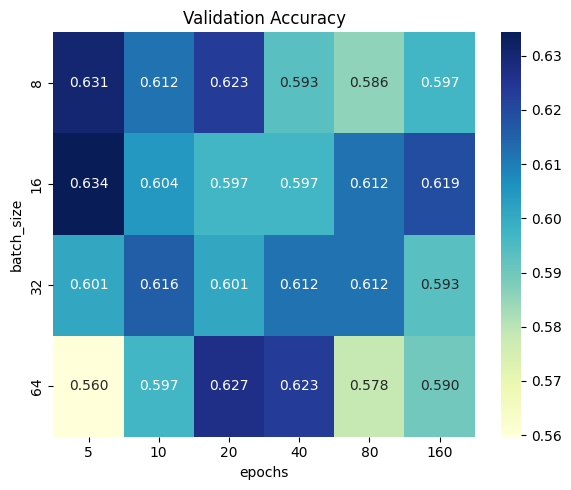

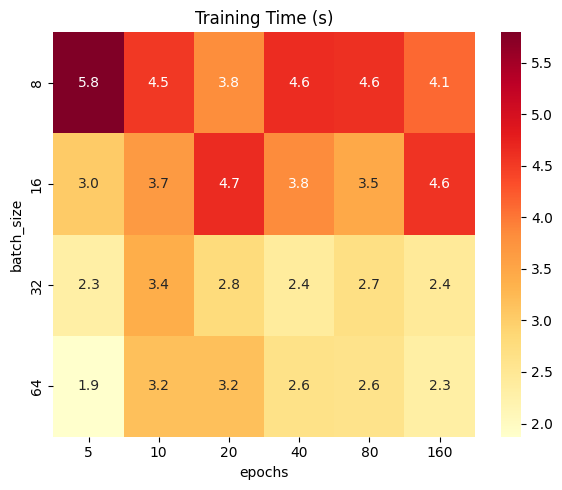


Grid search results:
     batch_size  epochs  val_accuracy  train_time_s
0            8       5      0.630597      5.794848
1            8      10      0.611940      4.529675
2            8      20      0.623134      3.824678
3            8      40      0.593284      4.633262
4            8      80      0.585821      4.608385
5            8     160      0.597015      4.109752
6           16       5      0.634328      3.034099
7           16      10      0.604478      3.659862
8           16      20      0.597015      4.652614
9           16      40      0.597015      3.846474
10          16      80      0.611940      3.464562
11          16     160      0.619403      4.578952
12          32       5      0.600746      2.302806
13          32      10      0.615672      3.402330
14          32      20      0.600746      2.790296
15          32      40      0.611940      2.407853
16          32      80      0.611940      2.690880
17          32     160      0.593284      2.444909
18      

/Users/beatrizfigueiredo/miniconda3/envs/mlProject3Python3_12/lib/python3.12/site-packages/keras/src/layers/core/masking.py:48: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.2993 - loss: 1.8853 - val_accuracy: 0.6782 - val_loss: 1.1269
Epoch 2/5
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.6943 - loss: 1.0759 - val_accuracy: 0.8161 - val_loss: 0.7431
Epoch 3/5
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8434 - loss: 0.6299 - val_accuracy: 0.8276 - val_loss: 0.6236
Epoch 4/5
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8948 - loss: 0.4147 - val_accuracy: 0.9195 - val_loss: 0.4199
Epoch 5/5
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.9087 - loss: 0.3741 - val_accuracy: 0.8506 - val_loss: 0.5655

Test Accuracy: 0.890
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


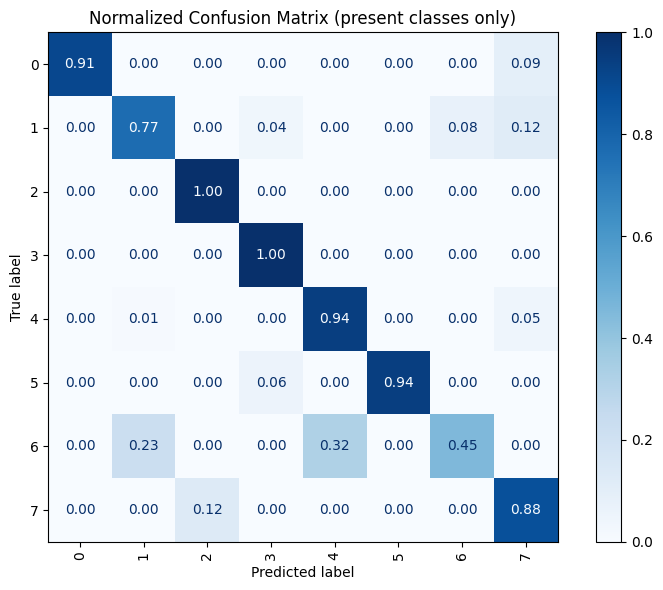


Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.91      0.95        22
           1       0.71      0.77      0.74        26
           2       0.94      1.00      0.97        16
           3       0.98      1.00      0.99        84
           4       0.89      0.94      0.92        87
           5       1.00      0.94      0.97        18
           6       0.88      0.45      0.60        31
           7       0.44      0.88      0.58         8

    accuracy                           0.89       292
   macro avg       0.85      0.86      0.84       292
weighted avg       0.90      0.89      0.89       292


LSTM Test Accuracy : 0.890
LSTM Precision     : 0.904
LSTM Recall        : 0.890
LSTM F₁-Score      : 0.887



In [3]:
# ---- 4) LSTM MODEL FACTORY ----
def make_lstm_model(input_shape, num_classes):
    lstm_model = tf.keras.Sequential([
        tf.keras.layers.Masking(mask_value=0.0, input_shape=input_shape),
        tf.keras.layers.LSTM(64),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(num_classes, activation="softmax")
    ])
    lstm_model.compile(
        optimizer="adam",
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"]
    )
    return lstm_model

# ---- 5) GRID‐SEARCH WITH EARLY STOPPING ----
lstm_results, lstm_histories = [], {}
for batch in batch_sizes:
    for epochs in epoch_sizes:
        print(f"\n>> batch={batch}, epochs={epochs}")
        model = make_lstm_model((TIME_STEPS, X_seq.shape[-1]), num_classes)
        es = tf.keras.callbacks.EarlyStopping(
            monitor="val_loss", patience=3, restore_best_weights=True
        )

        t0         = time.time()
        lstm_hist  = model.fit(
            X_train, y_train,
            validation_data=(X_val, y_val),
            batch_size=batch,
            epochs=epochs,
            callbacks=[es],
            verbose=1
        )
        dur        = time.time() - t0
        lstm_best  = max(lstm_hist.history["val_accuracy"])
        print(f" ↳ best val_acc={lstm_best:.3f}, time={dur:.1f}s")

        lstm_results.append({
            "batch_size":   batch,
            "epochs":       epochs,
            "val_accuracy": lstm_best,
            "train_time_s": dur
        })
        lstm_histories[(batch, epochs)] = lstm_hist

# ---- 6) VISUALIZE GRID‐SEARCH RESULTS ----
res_df     = pd.DataFrame(lstm_results)
pivot_acc  = res_df.pivot(index="batch_size", columns="epochs", values="val_accuracy")
pivot_time = res_df.pivot(index="batch_size", columns="epochs", values="train_time_s")

plt.figure(figsize=(6,5))
sns.heatmap(pivot_acc, annot=True, fmt=".3f", cmap="YlGnBu")
plt.title("Validation Accuracy");   plt.ylabel("batch_size"); plt.xlabel("epochs")
plt.tight_layout(); plt.show()

plt.figure(figsize=(6,5))
sns.heatmap(pivot_time, annot=True, fmt=".1f", cmap="YlOrRd")
plt.title("Training Time (s)");      plt.ylabel("batch_size"); plt.xlabel("epochs")
plt.tight_layout(); plt.show()

print("\nGrid search results:\n", res_df)

# ---- 7) FINAL TEST SET EVALUATION (only present classes) ----
best = res_df.sort_values("val_accuracy", ascending=False).iloc[0]
bb, be = int(best.batch_size), int(best.epochs)
print(f"\nRetrain on train+val with batch={bb}, epochs={be}")

lstm_final_model = make_lstm_model((TIME_STEPS, X_seq.shape[-1]), num_classes)
es               = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=3, restore_best_weights=True)
lstm_final_model.fit(
    np.concatenate([X_train, X_val]),
    np.concatenate([y_train, y_val]),
    batch_size=bb,
    epochs=be,
    validation_split=0.1,
    callbacks=[es],
    verbose=1
)

# Evaluate
lstm_loss, lstm_acc = lstm_final_model.evaluate(X_test, y_test, verbose=0)
print(f"\nTest Accuracy: {lstm_acc:.3f}")

# Only plot the confusion matrix for labels actually in y_test or y_pred
lstm_y_pred = lstm_final_model.predict(X_test).argmax(axis=1)
present     = np.unique(np.concatenate([y_test, lstm_y_pred]))

cm = confusion_matrix(
    y_test,
    lstm_y_pred,
    normalize="true",
    labels=present
)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=present)

fig, ax = plt.subplots(figsize=(8,6))
disp.plot(
    cmap="Blues",
    ax=ax,
    values_format=".2f",
    xticks_rotation="vertical"
)
plt.title("Normalized Confusion Matrix (present classes only)")
plt.tight_layout()
plt.show()

# And a classification report on the full range
print("\nClassification Report:\n",
      classification_report(y_test, lstm_y_pred, zero_division=0))

# additional metrics
from sklearn.metrics import (
    accuracy_score,
    precision_recall_fscore_support
)

lstm_acc2   = accuracy_score(y_test, lstm_y_pred)
lstm_prec, lstm_rec, lstm_f1, _ = precision_recall_fscore_support(
    y_test, lstm_y_pred, average='weighted'
)

print(f"\nLSTM Test Accuracy : {lstm_acc2:.3f}")
print(f"LSTM Precision     : {lstm_prec:.3f}")
print(f"LSTM Recall        : {lstm_rec:.3f}")
print(f"LSTM F₁-Score      : {lstm_f1:.3f}\n")


Validation Accuracy: 0.948
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


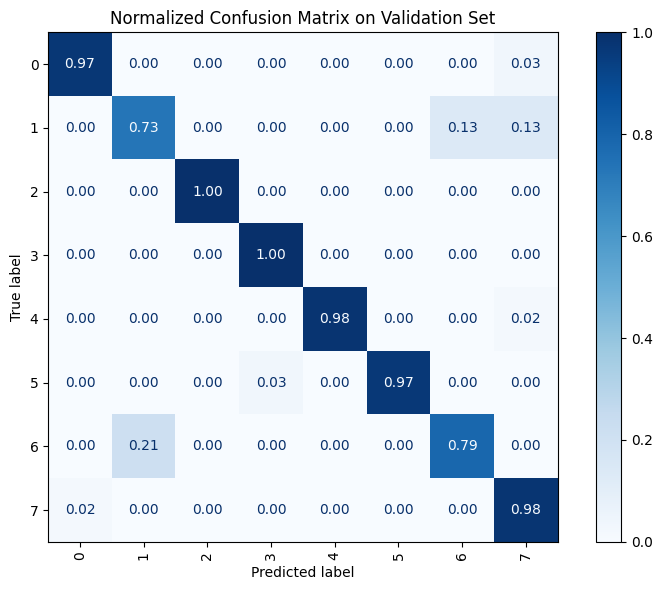


Validation Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.97      0.97        32
           1       0.65      0.73      0.69        15
           2       1.00      1.00      1.00        22
           3       0.97      1.00      0.99        33
           4       1.00      0.98      0.99        58
           5       1.00      0.97      0.98        29
           6       0.92      0.79      0.85        28
           7       0.93      0.98      0.95        51

    accuracy                           0.95       268
   macro avg       0.93      0.93      0.93       268
weighted avg       0.95      0.95      0.95       268


Validation Precision: 0.950
Validation Recall   : 0.948
Validation F₁-Score : 0.948


In [4]:

# 1) overall loss & accuracy
lstm_val_loss, lstm_val_acc = lstm_final_model.evaluate(X_val, y_val, verbose=0)
print(f"\nValidation Accuracy: {lstm_val_acc:.3f}")

# 2) predictions on validation
lstm_val_pred = lstm_final_model.predict(X_val).argmax(axis=1)

# 3) confusion matrix (normalized per‐class)
cm_val = confusion_matrix(y_val, lstm_val_pred, normalize="true")
disp_val = ConfusionMatrixDisplay(confusion_matrix=cm_val,
                                  display_labels=present)  # reuse `present` from before
fig, ax = plt.subplots(figsize=(8,6))
disp_val.plot(cmap="Blues", ax=ax, values_format=".2f", xticks_rotation="vertical")
plt.title("Normalized Confusion Matrix on Validation Set")
plt.tight_layout()
plt.show()

# 4) classification report
print("\nValidation Classification Report:\n",
      classification_report(y_val, lstm_val_pred, zero_division=0))

# 5) weighted precision/recall/f1
lstm_val_prec, lstm_val_rec, lstm_val_f1, _ = precision_recall_fscore_support(
    y_val, lstm_val_pred, average='weighted'
)
print(f"\nValidation Precision: {lstm_val_prec:.3f}")
print(f"Validation Recall   : {lstm_val_rec:.3f}")
print(f"Validation F₁-Score : {lstm_val_f1:.3f}")

In [5]:
#save model
lstm_final_model.save("../Models/lstm_final_model.h5")



▶ Training CNN with batch=8, epochs=5
Epoch 1/5


/Users/beatrizfigueiredo/miniconda3/envs/mlProject3Python3_12/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4141 - loss: 1.6152 - val_accuracy: 0.5896 - val_loss: 2.6206
Epoch 2/5
75/75 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7957 - loss: 0.6263 - val_accuracy: 0.5560 - val_loss: 3.0899
Epoch 3/5
75/75 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8420 - loss: 0.4316 - val_accuracy: 0.6119 - val_loss: 3.3725
Epoch 4/5
75/75 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9134 - loss: 0.2716 - val_accuracy: 0.6157 - val_loss: 3.3695
   ↳ best_val_acc=0.616, time=1.6s

▶ Training CNN with batch=8, epochs=10
Epoch 1/10
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.4345 - loss: 1.5918 - val_accuracy: 0.4701 - val_loss: 2.1924
Epoch 2/10
75/75 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8006 - loss: 0.6204 - val_accuracy: 0.6231 - val_loss: 2.5987
Epoch 3/10
75/75 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9151 - loss: 0.3143 - val_accuracy: 0.5970 - val_loss: 2.3818
Epoch 4/10
75/75 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accur

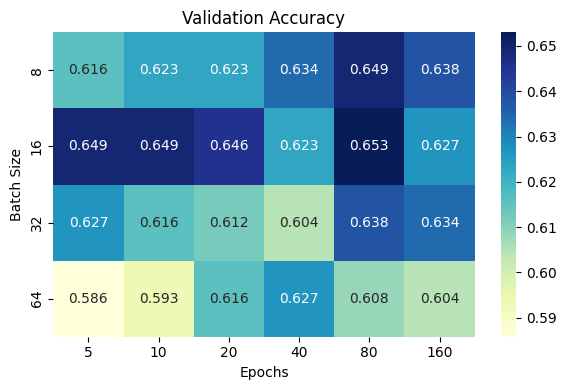

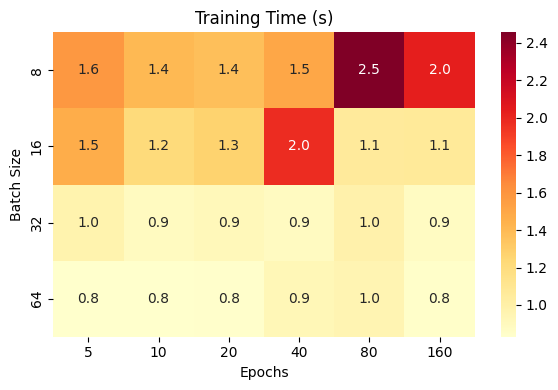

Best CNN params: batch=16, epochs=80
Epoch 1/80


/Users/beatrizfigueiredo/miniconda3/envs/mlProject3Python3_12/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4359 - loss: 1.6057 - val_accuracy: 0.9080 - val_loss: 0.5142
Epoch 2/80
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8397 - loss: 0.5570 - val_accuracy: 0.9195 - val_loss: 0.2908
Epoch 3/80
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8838 - loss: 0.3207 - val_accuracy: 0.8966 - val_loss: 0.2817
Epoch 4/80
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9209 - loss: 0.2335 - val_accuracy: 0.9310 - val_loss: 0.1955
Epoch 5/80
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9507 - loss: 0.1510 - val_accuracy: 0.9310 - val_loss: 0.4455
Epoch 6/80
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9559 - loss: 0.1300 - val_accuracy: 0.9195 - val_loss: 0.6279
Epoch 7/80
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9714 - loss: 0.1143 - val_accuracy: 0.9195 - val_loss: 0.3827
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


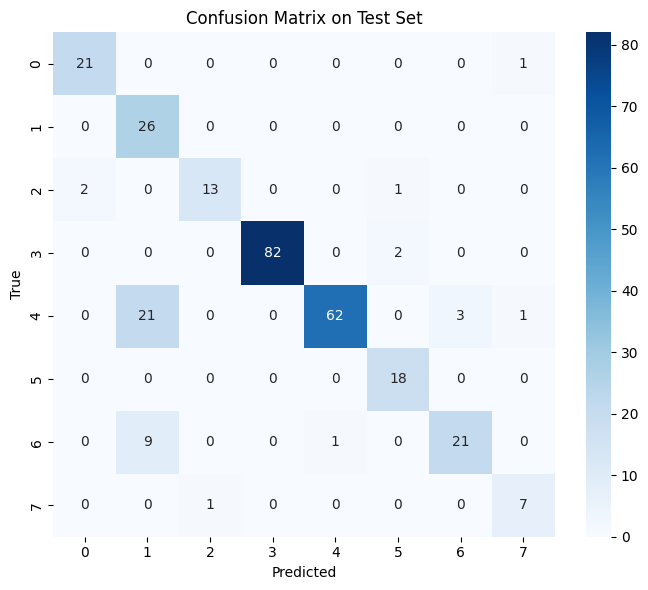

In [7]:
# ---- PARAMETERS ----
TIME_STEPS    = 50
batch_sizes   = [8, 16, 32, 64]
epoch_sizes   = [5, 10, 20, 40, 80, 160]
RANDOM_STATE  = 42

# ---- 2) CNN MODEL FACTORY ----
def make_cnn_model(input_shape, num_classes):
    cnn_model = tf.keras.Sequential([
        tf.keras.layers.Conv1D(64, kernel_size=3, activation="relu", input_shape=input_shape),
        tf.keras.layers.MaxPooling1D(pool_size=2),
        tf.keras.layers.Conv1D(128, kernel_size=3, activation="relu"),
        tf.keras.layers.MaxPooling1D(pool_size=2),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(64, activation="relu"),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(num_classes, activation="softmax"),
    ])
    cnn_model.compile(
        optimizer="adam",
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"]
    )
    return cnn_model

# ---- 3) GRID SEARCH ----
cnn_results = []

for cnn_batch in batch_sizes:
    for cnn_epochs in epoch_sizes:
        print(f"\n▶ Training CNN with batch={cnn_batch}, epochs={cnn_epochs}")
        cnn_model = make_cnn_model((TIME_STEPS, X_train.shape[-1]), num_classes)
        cnn_es    = tf.keras.callbacks.EarlyStopping(
            monitor="val_loss", patience=3, restore_best_weights=True
        )

        cnn_t0    = time.time()
        cnn_hist  = cnn_model.fit(
            X_train, y_train,
            validation_data=(X_val, y_val),
            batch_size=cnn_batch,
            epochs=cnn_epochs,
            callbacks=[cnn_es],
            verbose=1
        )
        cnn_elapsed     = time.time() - cnn_t0
        cnn_best_val_acc = max(cnn_hist.history["val_accuracy"])
        print(f"   ↳ best_val_acc={cnn_best_val_acc:.3f}, time={cnn_elapsed:.1f}s")

        cnn_results.append({
            "batch_size":   cnn_batch,
            "epochs":       cnn_epochs,
            "val_accuracy": cnn_best_val_acc,
            "train_time_s": cnn_elapsed
        })

# turn into DataFrame
cnn_res_df = pd.DataFrame(cnn_results)

# ---- 4) PLOT HEATMAPS ----
cnn_pivot_acc  = cnn_res_df.pivot(index="batch_size", columns="epochs", values="val_accuracy")
cnn_pivot_time = cnn_res_df.pivot(index="batch_size", columns="epochs", values="train_time_s")

plt.figure(figsize=(6,4))
sns.heatmap(cnn_pivot_acc, annot=True, fmt=".3f", cmap="YlGnBu")
plt.title("Validation Accuracy")
plt.ylabel("Batch Size"); plt.xlabel("Epochs")
plt.tight_layout(); plt.show()

plt.figure(figsize=(6,4))
sns.heatmap(cnn_pivot_time, annot=True, fmt=".1f", cmap="YlOrRd")
plt.title("Training Time (s)")
plt.ylabel("Batch Size"); plt.xlabel("Epochs")
plt.tight_layout(); plt.show()

# ---- 5) RE-TRAIN BEST & CONFUSION MATRIX ----
cnn_best = cnn_res_df.loc[cnn_res_df.val_accuracy.idxmax()]
cnn_bb   = int(cnn_best.batch_size)
cnn_be   = int(cnn_best.epochs)
print(f"Best CNN params: batch={cnn_bb}, epochs={cnn_be}")

# retrain on train+val
cnn_final_model = make_cnn_model((TIME_STEPS, X_train.shape[-1]), num_classes)
cnn_es2         = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss", patience=3, restore_best_weights=True
)
cnn_final_model.fit(
    np.vstack([X_train, X_val]),
    np.concatenate([y_train, y_val]),
    batch_size=cnn_bb,
    epochs=cnn_be,
    validation_split=0.1,
    callbacks=[cnn_es2],
    verbose=1
)

# evaluate on test set
cnn_y_pred = cnn_final_model.predict(X_test).argmax(axis=1)
cnn_cm     = confusion_matrix(y_test, cnn_y_pred)

plt.figure(figsize=(7,6))
sns.heatmap(cnn_cm, annot=True, fmt="d", cmap="Blues")
plt.title("Confusion Matrix on Test Set")
plt.xlabel("Predicted"); plt.ylabel("True")
plt.tight_layout(); plt.show()

In [8]:
acc = accuracy_score(y_test, cnn_y_pred)
prec, recall, f1, _ = precision_recall_fscore_support(
    y_test, cnn_y_pred, average='weighted'
)

print(f"Test Accuracy : {acc:.3f}")
print(f"Precision      : {prec:.3f}")
print(f"Recall         : {recall:.3f}")
print(f"F₁-Score       : {f1:.3f}\n")

print("Full Classification Report:\n")
print(classification_report(y_test, cnn_y_pred, digits=3))

Test Accuracy : 0.856
Precision      : 0.909
Recall         : 0.856
F₁-Score       : 0.865

Full Classification Report:

              precision    recall  f1-score   support

           0      0.913     0.955     0.933        22
           1      0.464     1.000     0.634        26
           2      0.929     0.812     0.867        16
           3      1.000     0.976     0.988        84
           4      0.984     0.713     0.827        87
           5      0.857     1.000     0.923        18
           6      0.875     0.677     0.764        31
           7      0.778     0.875     0.824         8

    accuracy                          0.856       292
   macro avg      0.850     0.876     0.845       292
weighted avg      0.909     0.856     0.865       292



9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


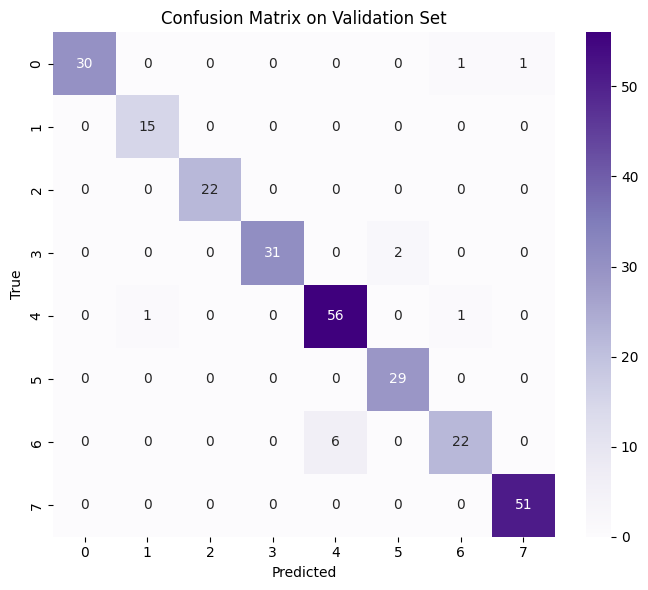

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


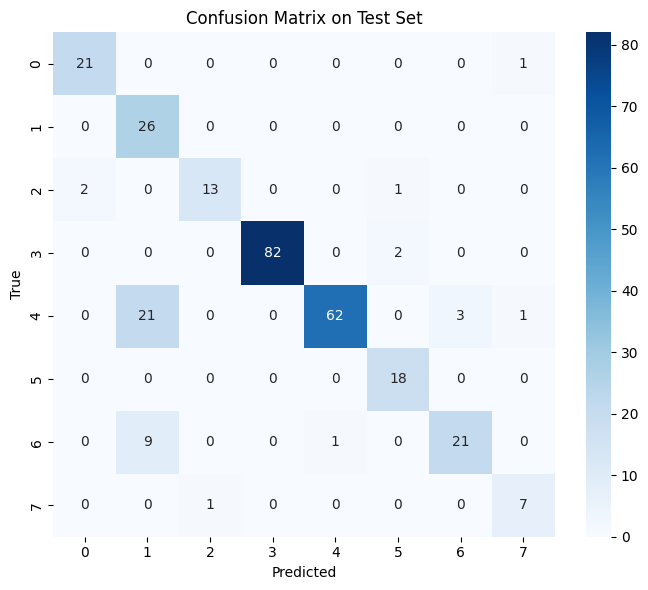

In [9]:
# ---- 6) CONFUSION MATRIX ON VALIDATION SET ----
cnn_y_val_pred = cnn_final_model.predict(X_val).argmax(axis=1)
cnn_cm_val     = confusion_matrix(y_val, cnn_y_val_pred)

plt.figure(figsize=(7,6))
sns.heatmap(cnn_cm_val, annot=True, fmt="d", cmap="Purples")
plt.title("Confusion Matrix on Validation Set")
plt.xlabel("Predicted"); plt.ylabel("True")
plt.tight_layout(); plt.show()

# ---- 7) CONFUSION MATRIX ON TEST SET ----
cnn_y_test_pred = cnn_final_model.predict(X_test).argmax(axis=1)
cnn_cm_test     = confusion_matrix(y_test, cnn_y_test_pred)

plt.figure(figsize=(7,6))
sns.heatmap(cnn_cm_test, annot=True, fmt="d", cmap="Blues")
plt.title("Confusion Matrix on Test Set")
plt.xlabel("Predicted"); plt.ylabel("True")
plt.tight_layout(); plt.show()

In [10]:
# save cnn
cnn_final_model.save("../Models/cnn_final_model.h5")

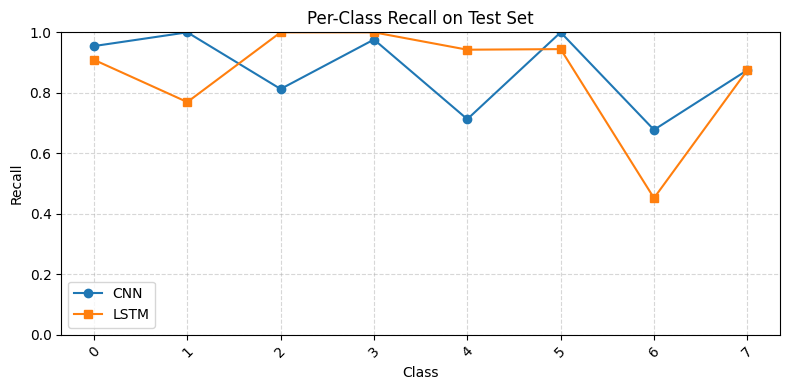

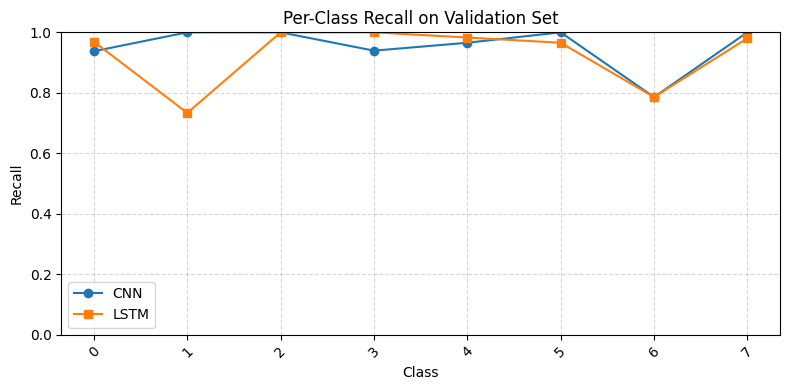

In [12]:
class_name = class_names = list(range(8))
def per_class_recall(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred, labels=range(len(class_names)))
    return np.diag(cm) / cm.sum(axis=1)

# compute recalls
cnn_test_rec  = per_class_recall(y_test,  cnn_y_test_pred)
lstm_test_rec = per_class_recall(y_test,  lstm_y_pred)

cnn_val_rec   = per_class_recall(y_val,   cnn_y_val_pred)
lstm_val_rec  = per_class_recall(y_val,   lstm_val_pred)

# 1) Test set comparison
plt.figure(figsize=(8,4))
plt.plot(class_names, cnn_test_rec, marker='o', label="CNN")
plt.plot(class_names, lstm_test_rec, marker='s', label="LSTM")
plt.title("Per-Class Recall on Test Set")
plt.xlabel("Class")
plt.ylabel("Recall")
plt.xticks(rotation=45)
plt.ylim(0,1)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()

# 2) Validation set comparison
plt.figure(figsize=(8,4))
plt.plot(class_names, cnn_val_rec, marker='o', label="CNN")
plt.plot(class_names, lstm_val_rec, marker='s', label="LSTM")
plt.title("Per-Class Recall on Validation Set")
plt.xlabel("Class")
plt.ylabel("Recall")
plt.xticks(rotation=45)
plt.ylim(0,1)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()

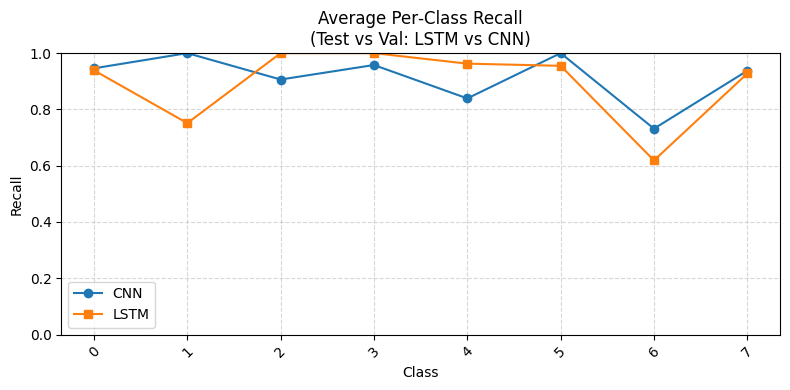

In [13]:
plt.figure(figsize=(8,4))
plt.plot(
    class_names, 
    (cnn_test_rec + cnn_val_rec) / 2, 
    marker='o', 
    label="CNN"
)
plt.plot(
    class_names, 
    (lstm_test_rec + lstm_val_rec) / 2, 
    marker='s', 
    label="LSTM"
)
plt.title("Average Per‐Class Recall\n(Test vs Val: LSTM vs CNN)")
plt.xlabel("Class")
plt.ylabel("Recall")
plt.xticks(rotation=45)
plt.ylim(0,1)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()

### CNN seems to be a better choiche

## Task 2


## MoViNet